# **Import du jeu de données** 

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
from google.colab import files

files.upload() # upload du fichier kaggle.json

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"clmentr","key":"91aa0c765a7bf190db6f16f4ac25128e"}'}

In [ ]:
! mkdir ~/.kaggle
! cp kaggle.json ~/.kaggle/
! chmod 600 ~/.kaggle/kaggle.json

In [ ]:
! kaggle datasets download -d daisukelab/dc2020task2 # téléchargement du dataset

100% 7.64G/7.65G [01:56<00:00, 68.5MB/s]
100% 7.65G/7.65G [01:56<00:00, 70.3MB/s]


In [ ]:
! mkdir dc2020task2
! unzip -q dc2020task2.zip -d dc2020task2
! rm dc2020task2.zip

In [ ]:
! pip -q install --upgrade librosa # upgrade de librosa pour éviter des erreurs sur Google Colab

     |████████████████████████████████| 184kB 5.3MB/s 
     |████████████████████████████████| 61kB 6.4MB/s 


In [ ]:
# import des librairies python nécessaires
import feather
import pickle
import itertools
import librosa
import librosa.display
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import tensorflow as tf
from glob import glob
from multiprocessing import Pool, cpu_count
from IPython.display import display, Audio
from keras.models import Sequential, Model, load_model
from keras import layers, callbacks, optimizers
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.metrics import roc_auc_score, f1_score
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from scipy.optimize import minimize, linear_sum_assignment

%matplotlib inline

# **Audit des données**

Notre jeu de données contient des fichiers audio de 6 machines, rangés dans 6 dossiers correspondants.
Chaque dossier contient deux sous-dossiers :
- un dossier train, qui rassemble un ensemble de fichiers audio de bruits normaux pour la machine correspondante,
- un dossier test, qui regroupe un ensemble de fichiers audio de bruits pour la machine correspondante, certains normaux, d'autres anormaux. On peut facilement les différencier de par leur nom ; en effet, les fichiers sont tous nommés de la même manière, à savoir un préfixe ("normal" pour les bruits normaux, "anomaly" pour les bruits anormaux), suivi d'un identifiant propre à l'enregistrement.

On peut donc créer un DataFrame rassemblant tous nos fichiers, et les classer par machine, par ensemble (train ou test). On peut également rajouter quelques informations propres à l'audio, à savoir la fréquence d'échantillonnage du fichier, ainsi que sa durée. Enfin, on peut labelliser ces fichiers suivant s'ils se rapportent à un bruit normal (1) ou anormal (0).

In [ ]:
# Récupération de tous les fichiers de la base de donnée
data_dir = './dc2020task2/'
data_files = glob(data_dir+'*/*/*.wav')
data = [f.split('/')[2:] for f in data_files]
label = [1 if f[2].startswith('normal') else 0 for f in data]
ID = [f[2].split('_')[2] for f in data]

# Récupération de quelques infos audio
def get_audio_infos(df):
    """
    Retourne la fréquence d'échantillonnage et la longueur
    du signal contenu dans le fichier df.
    """
    sig, f = librosa.load(df, sr=None)
    return f, len(sig)/f

p = Pool(cpu_count())
audio_infos = p.map(get_audio_infos, data_files)
p.close()
p.join()

# Assemblage du DataFrame
df = pd.DataFrame(data, columns=['engine', 'dir', 'name'])
df = df.join(pd.DataFrame(audio_infos, columns=['fs', 'length']))
df.insert(0, 'audio_path', data_files)
df.insert(6, 'label', label)
df.insert(3, 'ID', ID)
df.drop('name', axis=1, inplace=True)

# Classement du DataFrame pour avoir toujours les mêmes fichiers dans la suite
df.sort_values('audio_path', inplace=True)
df.reset_index(drop=True, inplace=True)

# Création d'un identifiant unique pour chaque ID de machine
engines = df.engine.unique()
df["label_e"] = (df.engine + df.ID).replace((df.engine + df.ID).unique(), 
                                            range(len((df.engine + df.ID).unique())))

# Sauvegarde du DataFrame pour usage ultérieur
df.to_feather('df.feather') 

df.head()

,audio_path,engine,dir,ID,fs,length,label,label_e
0,./dc2020task2/ToyCar/test/anomaly_id_01_000000...,ToyCar,test,01,16000,11.0,0,0
1,./dc2020task2/ToyCar/test/anomaly_id_01_000000...,ToyCar,test,01,16000,11.0,0,0
2,./dc2020task2/ToyCar/test/anomaly_id_01_000000...,ToyCar,test,01,16000,11.0,0,0
3,./dc2020task2/ToyCar/test/anomaly_id_01_000000...,ToyCar,test,01,16000,11.0,0,0
4,./dc2020task2/ToyCar/test/anomaly_id_01_000000...,ToyCar,test,01,16000,11.0,0,0


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30987 entries, 0 to 30986
Data columns (total 8 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   audio_path  30987 non-null  object 
 1   engine      30987 non-null  object 
 2   dir         30987 non-null  object 
 3   ID          30987 non-null  object 
 4   fs          30987 non-null  int64  
 5   length      30987 non-null  float64
 6   label       30987 non-null  int64  
 7   label_e     30987 non-null  int64  
dtypes: float64(1), int64(3), object(4)
memory usage: 1.9+ MB


In [ ]:
df.fs.value_counts()

16000    30987
Name: fs, dtype: int64

In [ ]:
df[['length', 'engine']].groupby(['length', 'engine']).count()

Empty DataFrame
Columns: []
Index: [(10.0, ToyConveyor), (10.0, fan), (10.0, pump), (10.0, slider), (10.0, valve), (11.0, ToyCar)]

On constate que notre jeu de données contient 30987 fichiers audio, tous échantillonnés à 16kHz.
On observe que la majorité des enregistrements dure 10s, à l'exception de ceux concernant le ToyCar, qui durent 11s.

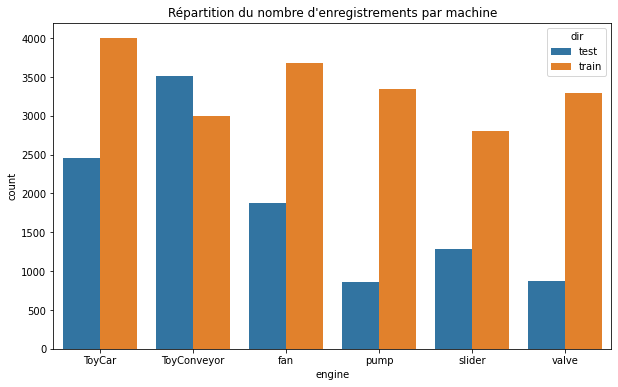

In [ ]:
fig, ax = plt.subplots(figsize=(10,6))
sns.countplot(x='engine', hue='dir', data=df, ax=ax)
ax.set_title("Répartition du nombre d'enregistrements par machine");

La figure précédente montre qu'on dispose globalement de plus de 2500 fichiers d'entrainement par machine, et d'au moins 800 fichiers de test pour chaque machine.

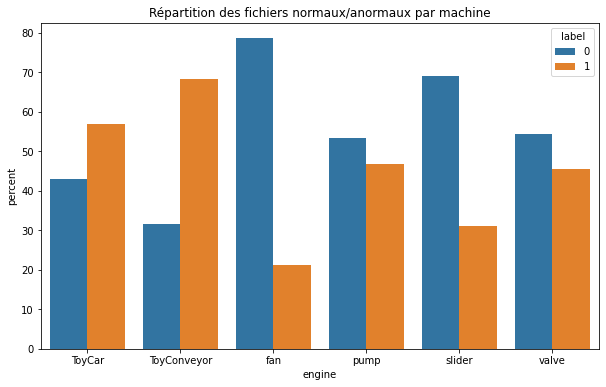

In [ ]:
fig, ax = plt.subplots(figsize=(10,6))
(df[(df.dir=='test')]
.groupby('engine')['label']
.value_counts(normalize=True)
.mul(100)
.rename('percent')
.reset_index()
.pipe((sns.barplot,'data'), x='engine', y='percent', hue='label', ax=ax))
ax.set_title("Répartition des fichiers normaux/anormaux par machine");


La figure ci-dessus montre le pourcentage de fichiers normaux et anormaux dans l'ensemble de test. On constate que les valeurs sont plutôt disparates, sans toutefois constituer un déséquilibre trop important, le ratio le plus grand étant de 1 pour 5.

Toutefois, il faut pousser notre enquête un peu plus loin, chaque type de machine étant représenté par plusieurs machines, identifiées par ID dans le nom de fichier.

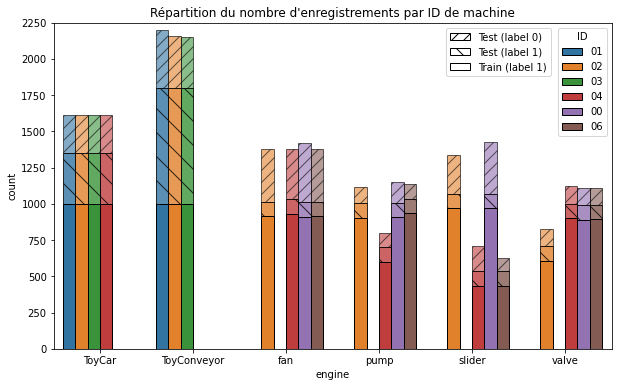

In [ ]:
df_test = df[df.dir == 'test']

fig, ax = plt.subplots(figsize=(10,6))

p = sns.countplot(x='engine', hue='ID', data=df_test[df_test.label==0], 
                  ax=ax, alpha=0.6, edgecolor='k')
sns.countplot(x='engine', hue='ID', data=df_test[df_test.label==1], 
              alpha=0.8, edgecolor='k')
sns.countplot(x='engine', hue='ID', data=df[df.dir=='train'], edgecolor='k')
for ci, cont in enumerate(p.containers[11::-1]):
    for bi, bar in enumerate(cont):
        y = p.containers[17-ci][bi].get_y()
        h = p.containers[17-ci][bi].get_height()
        bar.set_y(y+h)
        if ci < 6:
            bar.set_hatch('\\')
        else:
            bar.set_hatch('//')
        
from matplotlib.patches import Patch
legend_elements = [Patch(facecolor="w", edgecolor='k', hatch='//'),
                   Patch(facecolor="w", edgecolor='k', hatch='\\'),
                   Patch(facecolor="w", edgecolor='k', hatch='')]

ax.set_ylim(0, 2250)
ax.set_title("Répartition du nombre d'enregistrements par ID de machine")

handles, labels = ax.get_legend_handles_labels()
leg = plt.legend(handles[12:], labels[12:], title="ID", loc='upper right')
ax.legend(legend_elements, ['Test (label 0)', 'Test (label 1)', 
                            'Train (label 1)'], 
          loc='upper right', bbox_to_anchor=(0.4, 0.5, 0.5, 0.5))
plt.gca().add_artist(leg);

On constate qu'il y a entre 3 et 4 machines différentes pour chaque type de machine, et on peut confirmer que les jeux de données ne sont pas trop déséquilibrés.

Il est vrai que pour une problématique de détection d'anomalie, on s'attend à trouver les données anormales en minorité, mais ce n'est généralement pas le cas ici.

Il reste à vérifier (à l'oreille) que les ID de machine identifient la même machine dans les données train et test.

In [ ]:
label_e = 4 # identifiant unique de machine, entre 0 et 22

# Affichage d'un fichier Train
data = df[(df.label_e==label_e) & (df.dir=='train')].iloc[0]
file = data.audio_path
signal, fe = librosa.load(file, sr=None)

print(data.engine + ' - ID' + data.ID + ' - Train')
print(file.split("/")[-1])
display(Audio(data=signal, rate=fe))

# Affichage d'un fichier Train
data = df[(df.label_e==label_e) & (df.dir=='test') & (df.label==1)].iloc[0]
file = data.audio_path
signal, fe = librosa.load(file, sr=None)

print(data.engine + ' - ID' + data.ID + ' - Test')
print(file.split("/")[-1])
display(Audio(data=signal, rate=fe))

ToyConveyor - ID01 - Train
normal_id_01_00000000.wav


ToyConveyor - ID01 - Test
normal_id_01_00000000.wav


# **Visualisation des données**

Nous nous intéressons désormais aux caractéristiques propres à nos fichiers audio, à savoir dans un premier temps la forme d'onde des signaux, puis leur contenu spectral.
Tout d'abord, traçons deux signaux temporels d'entrainement (donc normaux) par machine.

In [ ]:
# Fonctions pour le traitement des fichiers audio
def plot_audio(audio_data, fe, ax):
    """
    Plot le signal temporel audio_data à la fréquence 
    d'échantillonnage fe sur l'axe ax.
    """
    # Intervalle de temps entre deux points.
    dt = 1/fe 
    # Variable de temps en seconde.
    t = dt*np.arange(len(audio_data)) 
    ax.plot(t, audio_data)
    ax.set_xlim(0, 10)
    ax.set_xlabel("Time (s)")
    ax.set_ylabel("Amplitude")

def logSpectrogram(audio):
    """
    Retourne la STFT de audio en dB.
    """
    D_highres = librosa.stft(audio, hop_length=512, n_fft=1024)
    S_db_hr = librosa.amplitude_to_db(np.abs(D_highres), ref=np.max)
    return S_db_hr

def plot_Spectrogram(y, fe, ax):
    """
    Retourne le spectrogramme de y à la fréquence 
    d'échantillonnage fe sur l'axe ax.
    La fréquence est tracée linéairement.
    """
    img = librosa.display.specshow(logSpectrogram(y), hop_length=512, sr=fe, 
                                   x_axis='time', y_axis='linear', ax=ax)
    plt.colorbar(img, ax=ax, format="%+2.f dB")
    ax.set_xlim(0, 10)
    ax.set_ylim(20, fe//2)
    ax.set_xlabel('Time (s)')
    ax.set_ylabel('Frequency (Hz)')

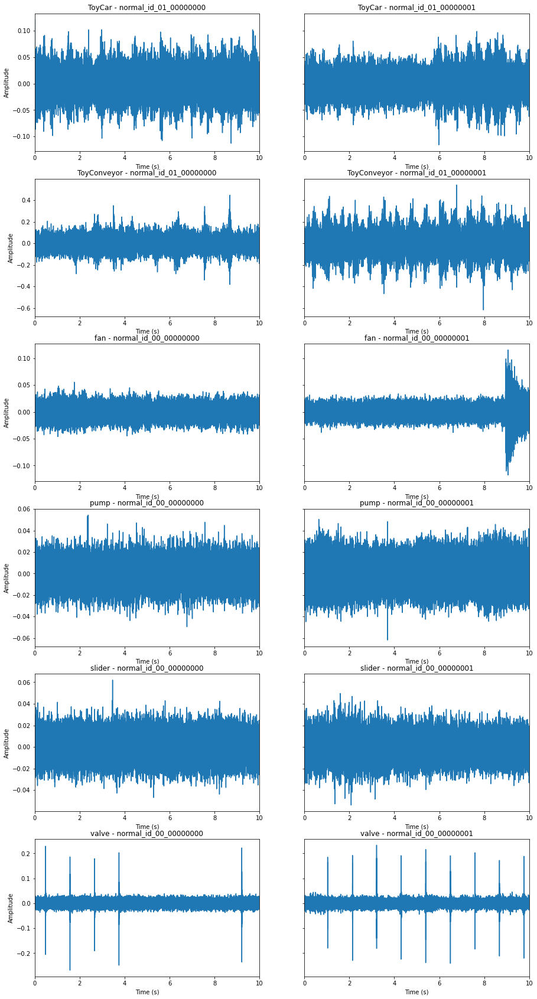

In [ ]:
# Bruits normaux (signaux temporels)
fig, axes = plt.subplots(len(engines), 2, figsize=(15,30), sharey='row')
for i, j in itertools.product(range(len(engines)), range(2)):
    # Load data
    file = df[(df.engine==engines[i]) & (df.dir=='train')].audio_path.iloc[j]
    signal, fe = librosa.load(file, sr=None)
    
    # Plot data
    plot_audio(signal, fe, axes[i,j])
    axes[i,j].set_title(' - '.join((engines[i], file.split("/")[-1][:-4])))
    if j!=0 : axes[i,j].set_ylabel(None)

On observe déjà que les sons ne sont globalement pas 
homogènes.
- Pour la valve : on constate sur un fichier que les impacts périodiques disparaissent pendant quelques secondes.
- Pour le ToyCar, le ToyConveyor : on observe des variations de niveau plus importantes sur un fichier que sur l'autre.
- Pour le fan, la pump, le slider : les deux sons semblent se ressembler.

Les spectrogrammes ci-après, qui nous permettent de visualiser une information sur le contenu fréquentiel des enregistrements, confirment ces observations. On peut compléter notre constat précédent, en associant aux variations de niveau sonore des variations de contenu spectral, et l'apparition de tonalités continues sur la plupart des machines.


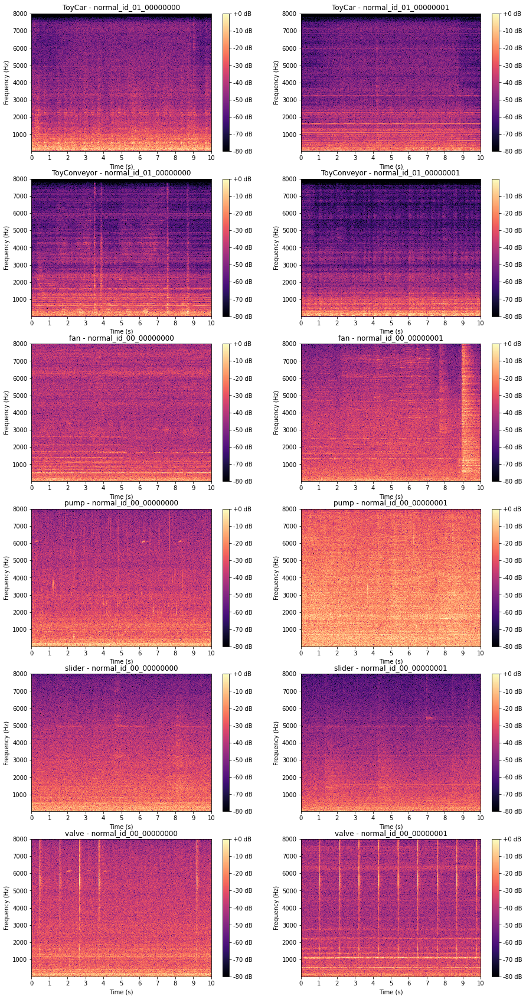

In [ ]:
# Bruits normaux (spectragrammes)
fig, axes = plt.subplots(6, 2, figsize=(15,30))
for i, j in itertools.product(range(len(engines)), range(2)):
    # Load data
    file = df[(df.engine==engines[i]) & (df.dir=='train')].audio_path.iloc[j]
    signal, fe = librosa.load(file, sr=None)
    
    # Plot data
    plot_Spectrogram(signal, fe, axes[i,j])
    axes[i,j].set_title(' - '.join((engines[i], file.split("/")[-1][:-4])))

In [ ]:
# Bruits normaux (audios)
for i, j in itertools.product(range(len(engines)), range(2)):
    # Load data
    file = df[(df.engine==engines[i]) & (df.dir=='train')].audio_path.iloc[j]
    signal, fe = librosa.load(file, sr=None)
    
    # Display audio
    print(' - '.join((engines[i], file.split("/")[-1])))
    display(Audio(data=signal, rate=fe))

ToyCar - normal_id_01_00000000.wav


ToyCar - normal_id_01_00000001.wav


ToyConveyor - normal_id_01_00000000.wav


ToyConveyor - normal_id_01_00000001.wav


fan - normal_id_00_00000000.wav


fan - normal_id_00_00000001.wav


pump - normal_id_00_00000000.wav


pump - normal_id_00_00000001.wav


slider - normal_id_00_00000000.wav


slider - normal_id_00_00000001.wav


valve - normal_id_00_00000000.wav


valve - normal_id_00_00000001.wav


Comparons maintenant, pour chaque machine, l'un des fichiers normaux avec deux fichiers anormaux, afin d'observer la forme que peuvent prendre les anormalités à détecter. On prend soin de comparer les ID identiques.

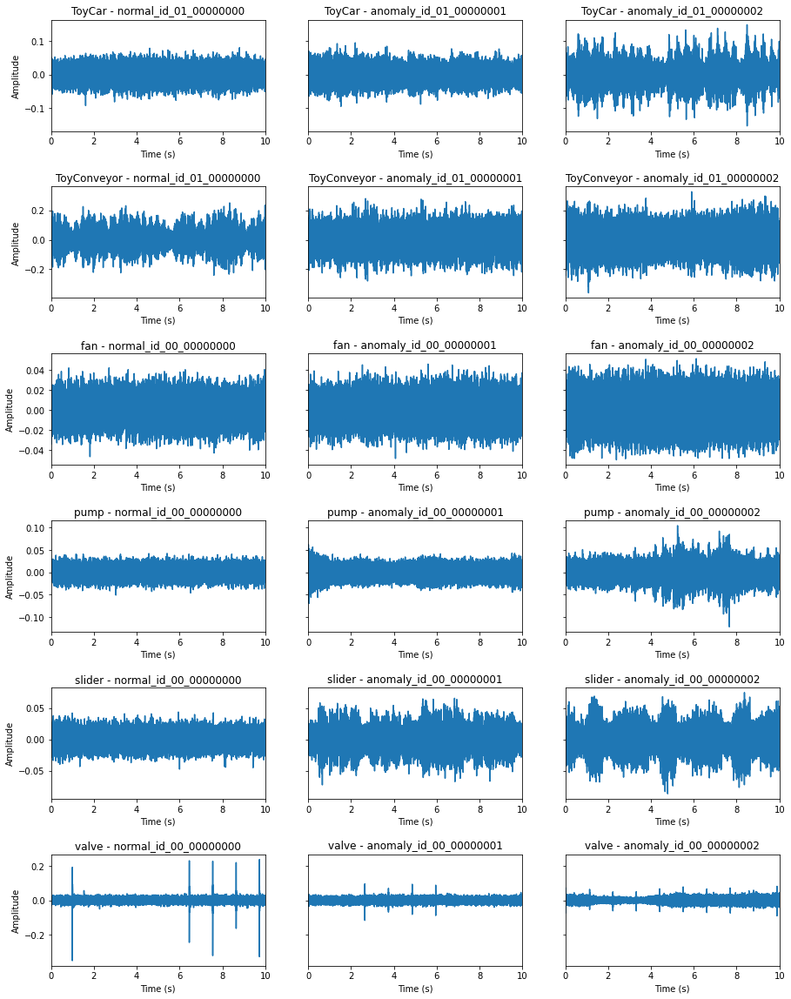

In [ ]:
# Comparaison bruits normaux/bruits anormaux (signaux temporels)
fig, axes = plt.subplots(len(engines), 3, figsize=(15,20), sharey='row')
for i, j in itertools.product(range(len(engines)), range(3)):
    # Load data
    if j == 0:
        file = df[(df.engine==engines[i]) & (df.label==1)].audio_path.iloc[j]
    else:
        file = df[(df.engine==engines[i]) & (df.label==0)].audio_path.iloc[j]
    signal, fe = librosa.load(file, sr=None)
    
    # Plot data
    plot_audio(signal, fe, axes[i,j])
    axes[i,j].set_title(' - '.join((engines[i], file.split("/")[-1][:-4])))
    if j!=0 : axes[i,j].set_ylabel('')
plt.subplots_adjust(hspace=0.5);

Avec les signaux temporels, il peut être difficile de détecter des anomalies. En effet, on ne distingue pas toujours de variation claire. On peut toutefois détecter des anomalies dans certains cas : variations importantes de niveau (ToyConveyor, pump, slider, fan), impacts (valve, ToyCar), les variations observées sont du même ordre que ce que l'on a pu voir entre deux fichiers normaux. Les spectrogrammes vont certainement nous apporter plus d'information.


(513, 313)

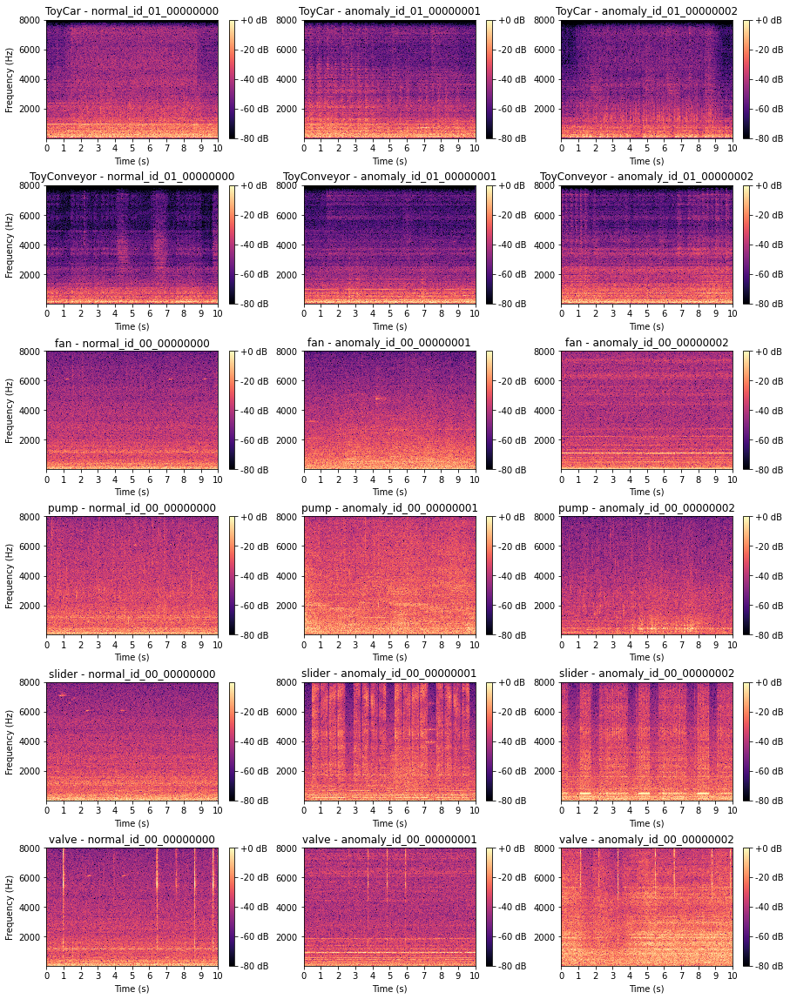

In [ ]:
# Comparaison bruits normaux/bruits anormaux (spectrogrammes)
fig, axes = plt.subplots(6, 3, figsize=(15,20))
for i, j in itertools.product(range(len(engines)), range(3)):
    # Load data
    if j == 0:
        file = df[(df.engine==engines[i]) & (df.label==1)].audio_path.iloc[j]
    else:
        file = df[(df.engine==engines[i]) & (df.label==0)].audio_path.iloc[j]
    signal, fe = librosa.load(file, sr=None)
    
    # Plot data
    plot_Spectrogram(signal, fe, axes[i,j])
    axes[i,j].set_title(' - '.join((engines[i], file.split("/")[-1]))[:-4])
    if j!=0 : axes[i,j].set_ylabel(None)
plt.subplots_adjust(hspace=0.4);
logSpectrogram(signal).shape

In [ ]:
# Comparaison bruits normaux/bruits anormaux (audios)
for i, j in itertools.product(range(len(engines)), range(3)):
    # Load data
    if j == 0:
        file = df[(df.engine==engines[i]) & (df.label==1)].audio_path.iloc[j]
    else:
        file = df[(df.engine==engines[i]) & (df.label==0)].audio_path.iloc[j]
    signal, fe = librosa.load(file, sr=None)
    
    # Display audio
    print(' - '.join((engines[i], file.split("/")[-1])))
    display(Audio(data=signal, rate=fe))

ToyCar - normal_id_01_00000000.wav


ToyCar - anomaly_id_01_00000001.wav


ToyCar - anomaly_id_01_00000002.wav


ToyConveyor - normal_id_01_00000000.wav


ToyConveyor - anomaly_id_01_00000001.wav


ToyConveyor - anomaly_id_01_00000002.wav


fan - normal_id_00_00000000.wav


fan - anomaly_id_00_00000001.wav


fan - anomaly_id_00_00000002.wav


pump - normal_id_00_00000000.wav


pump - anomaly_id_00_00000001.wav


pump - anomaly_id_00_00000002.wav


slider - normal_id_00_00000000.wav


slider - anomaly_id_00_00000001.wav


slider - anomaly_id_00_00000002.wav


valve - normal_id_00_00000000.wav


valve - anomaly_id_00_00000001.wav


valve - anomaly_id_00_00000002.wav


Les spectrogrammes nous donnent des informations plus complètes que les signaux temporels. On peut en effet généralement discerner les anormalités, ce que l'on va tenter de faire pour chaque machine.
- Pour le ToyCar : on observe une variation de niveau dans les haut-mediums pour les machines anormales, chose que l'on n'observe pas sur la machine normale.
- Pour le ToyConveyor : les différences sont difficilement caractérisables sur cette machine. Une écoute permet de constater que les bruits anormaux contiennent des impacts réguliers, qui ne s'entendent pas sur un bruit normal.
- Pour le fan : on observe la présence de tonalités constantes et de bruits d'impacts faiblement amortis sur les machines anormales, inexistants sur la machine normale.
- Pour la pump : la machine normale génère une tonalité constante que l'on ne retrouve pas (ou différemment) sur machine anormale.
- Pour le slider : on observe la présence d'un bruit large bande intermittent qui n'apparait pas sur la machine normale.
- Pour la valve : les impacts cycliques que l'on observe sur le bruit normal présentent une irrégularité sur machine anormale (chose que l'on avait observé sur les signaux temporels), au profit d'un contenu spectral aigu moins fourni. On observe également l'apparitions d'impacts faiblement amortis.

Ainsi, les spectrogrammes nous fournissent des informations qui permettent presque systématiquement de discriminer les bruits anormaux.
Cependant, ce n'est pas systématique, et il va falloir que les algorithmes de classification soient plus forts que nous pour discerner les anomalies que l'on ne voit pas.
Un paramétrage plus fin peut être nécessaire pour calculer les spectrogrammes. En tous cas, l'écoute des sons nous informe sur les bruits anormaux non identifiés visuellement.

# **Détection d'anomalie par autoencodeur convolutif**


Notre problème présente toutes les caractéristiques d'une détection d'anomalies : à partir de données normales, il nous faut détecter celles qui sont anormales. 
Au regard du nombre important de features nécessaires pour caractériser un signal audio, la solution qui semble la meilleure est l'autoencodeur. 

L'usage de l'autoencodeur est multiple. Initialement utilisé pour réduire les dimensions des données d'entrée, il peut aussi être utilisé comme débruiteur, ou comme détecteur d'anomalies. Cette dernière fonction est celle qui nous intéresse. En entrainant un autoencodeur sur des données normales, en cherchant à minimiser l'écart entre les données d'entrée et les données de sortie - on parle donc d'erreur de reconstruction, il devrait en extraire les caractéristiques principales. Puis, en appliquant le modèle aux données test, les données normales, semblables aux données d'entrainement, devraient produire une faible erreur. En revanche, les données anormales sont censées générer une erreur de reconstruction plus importante, c'est ce qui nous permettra de les discriminer.

La construction d'un autoencodeur semble simple, et toutes les versions que l'on peut trouver se ressemblent, qu'il s'agisse d'autoencodeur _dense_ ou convolutionnels.
Toutefois, peu expérimentés dans le domaine, nous avons testé une multitude de configurations diverses, et ce sans succès : face à des problèmes de compression trop élevée, trop faible, une erreur de reconstruction invariante, etc., cette recherche a été très instructive mais n'a pas produit les résultats attendus.

Nous nous sommes donc finalement orientés vers le modèle d'auto-encodeur convolutionnel décrit dans une publication qui se trouve traiter le même problème que nous : détection d'anomalies de fichiers audio (il s'agit en fait du rapport technique de participants au challenge DCASE 2020). Cette publication est accessible au lien suivant : https://dcase.community/documents/challenge2020/technical_reports/DCASE2020_Pilastri_86_t2.pdf

## Préparation des données

Alors que l'on se proposait de travailler avec des spectrogrammes classiques (basés sur la fréquence) dans un premier temps pour représenter nos données audio, nous avons ensuite pensé à utiliser l'échelle des Mel. Cette échelle, conçue comme une échelle psychoacoustique de hauteur des sons (par des personnes n'étant visiblement pas musiciens, puisque sa définition vient en contradiction avec la théorie de la musique), est liée aux hertz par dépendance logarithmique. Elle rend ainsi mieux compte de ce qui se passe dans les graves par rapport aux aigus, et son étendue est plus réduite. On peut alors réduire le nombre de coefficients obtenus par filtrage sans perte d'information importante dans notre cas.

Ayant connaissance de l'usage de la transformation d'un signal en Mel-frequency cepstral coefficients (MFCC), nous avons d'abord opté pour ce choix, avant de découvrir dans la publication précédemment citée les MFEC, (Mel-frequency energy coefficients) qui sont construits de manière semblable à l'exception de la transformée discrète en cosinus des MFCC qui supprime la corrélation entre les coefficients. Cette dernière a pourtant son intérêt dans les CNN, qui savent extraire ce genre d'information. C'est pourquoi nous nous sommes finalement orientés vers l'utilisation des MFEC pour représenter nos données d'entrée.

In [ ]:
# Fonctions pour le calcul des MFECs et le découpage des données en frames
from librosa.feature import melspectrogram
from librosa.core import power_to_db

def mfec(y=None, sr=22050, S=None, n_mfec=20, **kwargs):
    """Mel-frequency energy coefficients (MFECs)

    Parameters
    ----------
    y : np.ndarray [shape=(n,)] or None
        audio time series

    sr : number > 0 [scalar]
        sampling rate of ``y``

    S : np.ndarray [shape=(d, t)] or None
        log-power Mel spectrogram

    n_mfcec: int > 0 [scalar]
        number of MFECs to return

    kwargs : additional keyword arguments
        Arguments to `melspectrogram`, if operating
        on time series input

    Returns
    -------
    M : np.ndarray [shape=(n_mfec, t)]
        MFEC sequence
    """
    if S is None:
        S = power_to_db(melspectrogram(y=y, sr=sr, power=1, **kwargs))

    M = S[:n_mfec]    
    return M

def MFEC(filename):
    """
    Renvoie les MFEC du fichier audio filename
    """
    Tmax = 10
    audio, fs = librosa.load(filename, sr=None, res_type='kaiser_fast') 
    mfecs = mfec(y=audio[:Tmax*fs], sr=fs, n_mfec=n_mfec,
                 n_fft=1024, hop_length=512)

    return mfecs

def plot_MFEC_Spectrogram(mfecs, fe, ax):
    """
    Trace le MFEC spectrogramme mfecs à la fréquence 
    d'échantillonnage fe sur l'axe ax.
    La fréquence est tracée linéairement.
    """
    img = librosa.display.specshow(mfecs, sr=fe, x_axis='time', ax=ax,
                                   hop_length=512)
    plt.colorbar(img, ax=ax, format="%+2.f")
    ax.set_xlim(0, 10)
    ax.set_xlabel('Time (s)')
    ax.set_ylabel('MFEC')

def frame_data(data, batch_size, hop_size):
    """
    Cette fonction découpe les N matrices MxL de l'entrée data
    en batch de taille batch_size avec un saut de hop_size.
    """
    data_framed = []
    for i in range(data.shape[0]):
        frames = []
        idx = 0
        while idx+batch_size <= data.shape[2]:
            frames.append(data[i,:,idx:idx+batch_size])
            idx += hop_size
        data_framed.append(np.asarray(frames))
    return np.asarray(data_framed)


def unframe_data(data, n_obs, n_frame_obs, n_mfec, batch_size, hop_size):
    """
    Cette fonction restaure les N matrices MxL de l'entrée data
    à partir des batch de taille batch_size avec un saut de hop_size.
    """
    reconstructed = np.zeros((n_obs, n_mfec,(n_frame_obs-1)*hop_size+batch_size))
    for i in range(n_obs):
        compteur = np.zeros(((n_frame_obs-1)*hop_size+batch_size))
        for n in range(n_frame_obs):
            start = n*hop_size
            reconstructed[i,:,start:start+batch_size] += data[i,n]
            compteur[start:start+batch_size] += 1
        reconstructed[i] = reconstructed[i] / np.tile(compteur, (n_mfec, 1))
    return reconstructed
 

(128, 313)

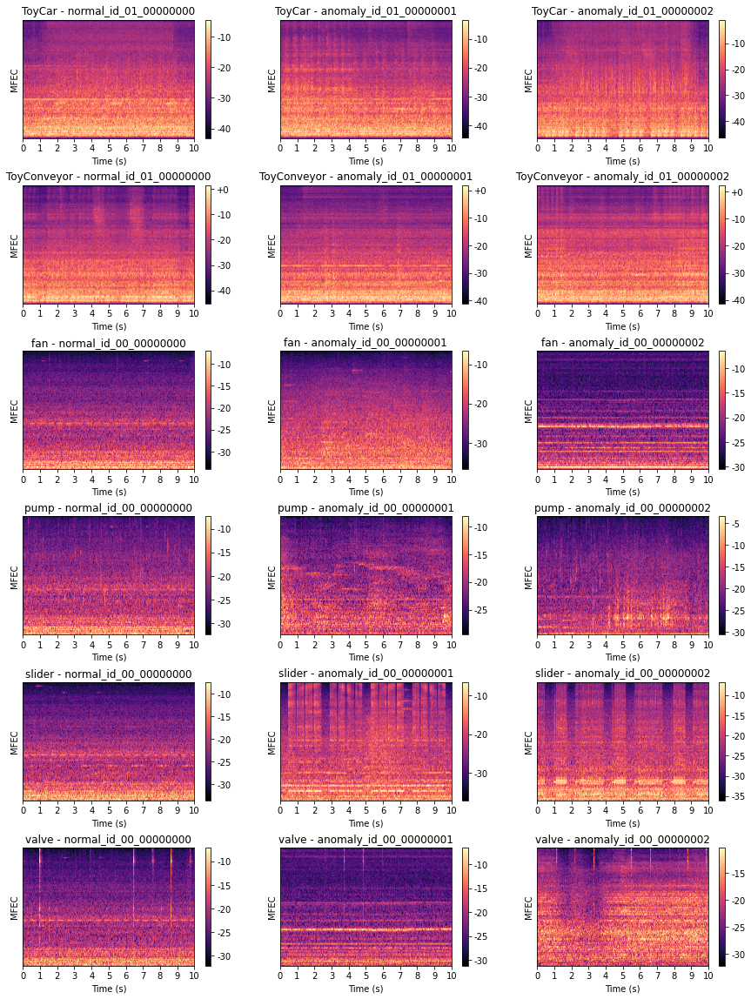

In [ ]:
# Comparaison bruits normaux/bruits anormaux (MFEC)
n_mfec = 128
fig, axes = plt.subplots(6, 3, figsize=(15,20))
for i, j in itertools.product(range(len(engines)), range(3)):
    # Load data
    if j == 0:
        file = df[(df.engine==engines[i]) & (df.label==1)].audio_path.iloc[j]
    else:
        file = df[(df.engine==engines[i]) & (df.label==0)].audio_path.iloc[j]
    signal, fe = librosa.load(file, sr=None, res_type='kaiser_fast')
    
    # Plot data
    Tmax = 10
    mfecs = mfec(y=signal[:Tmax*fe], sr=fe, n_mfec=n_mfec,
                 n_fft=1024, hop_length=512)
    plot_MFEC_Spectrogram(mfecs, fe, ax=axes[i,j])
    axes[i,j].set_title(' - '.join((engines[i], file.split("/")[-1]))[:-4])
plt.subplots_adjust(hspace=0.4);
mfecs.shape

On constate sur la figure ci-dessus que la représentation des données par les MFEC contient suffisamment d'informations pour conserver les éléments différenciants. On note toutefois que chaque décomposition est formée de 128 x 313 valeurs, soit 40064 valeurs, alors qu'on en avait plus de quatre fois plus avec les spectrogrammes (513 x 313, soit 160569 valeurs), pour un même nombre de points dans la FFT (1024, avec un overlap de 50%).
Toutefois, cela fait encore beaucoup de données d'un coup. Nous allons donc découper chaque signal en frames de 32 échantillons, qui durent donc environ 1 s, avec un overlap de 4 échantillons, soit un peu plus de 100 ms.

In [ ]:
p = Pool(cpu_count())
Train = p.map(MFEC, df[df.dir=='train'].audio_path)
p.close()
p.join()
Train = np.asarray(Train)

# Normalisation des données
scaler = StandardScaler()
Train = scaler.fit_transform(Train.reshape(-1, 
                                           Train.shape[-1])).reshape(Train.shape)

np.save('drive/My Drive/Train_MFEC.npy', Train)

In [ ]:
p = Pool(cpu_count())
Test = p.map(MFEC, df[df.dir=='test'].audio_path)
p.close()
p.join()
Test = np.asarray(Test)

# Normalisation des données
Test = scaler.transform(Test.reshape(-1, Test.shape[-1])).reshape(Test.shape)

np.save('drive/My Drive/Test_MFEC.npy', Test)

In [ ]:
# Fabrication des matrices Train et Test contenant les MFEC de chaque fichier.
n_mfec = 128
batch_size = 32
hop_size = 28

df_train = df[df.dir=='train']
df_test = df[df.dir=='test']

for l in df.label_e.unique():
    # Découpage en frames
    Train_framed = frame_data(Train[df_train.label_e==l], batch_size, hop_size)
    Test_framed = frame_data(Test[df_test.label_e==l], batch_size, hop_size)

    # Enregistrement des données pour soulager la RAM
    np.save('drive/My Drive/Train_framed_MFEC_' + str(l) +'.npy', Train_framed)
    np.save('drive/My Drive/Test_framed_MFEC_' + str(l) + '.npy', Test_framed)

## Modèle

Comme indiqué plus haut, le modèle est un autoencodeur convolutionnel. La partie encodeur est composée de 5 couches convolutionnelles.

In [ ]:
class ConvAnomalyDetector(Model):
    """
    Définition du modèle d'autoencodeur convolutionnel.
    """
    def __init__(self):
        """
        Initialisation de la classe avec un encodeur et un décodeur
        à 5 couches convolutionnelles.
        """
        super(ConvAnomalyDetector, self).__init__()
        self.encoder = Sequential([
            layers.InputLayer(input_shape=(n_mfec, batch_size, 1)),
            layers.Conv2D(32, 5, strides=(2, 1), padding='same'),
            layers.BatchNormalization(),
            layers.ReLU(),
            layers.Dropout(0.2),
            layers.Conv2D(64, 5, strides=(2,1), padding='same'),
            layers.BatchNormalization(),
            layers.ReLU(),
            layers.Dropout(0.2),
            layers.Conv2D(128, 5, strides=(2, 2), padding='same'),
            layers.BatchNormalization(),
            layers.ReLU(),
            layers.Dropout(0.2),
            layers.Conv2D(256, 3, strides=(2, 2), padding='same'),
            layers.BatchNormalization(),
            layers.ReLU(),
            layers.Dropout(0.2),
            layers.Conv2D(512, 3, strides=(2, 2), padding='same'),
            layers.BatchNormalization(),
            layers.ReLU(),
            layers.Dropout(0.2),
            layers.Conv2D(40, 4, padding='valid'),
            layers.Flatten()])
    
        self.decoder = Sequential([
            layers.Dense(np.prod(self.encoder.layers[-3].output_shape[1:]),
                       activation='relu'),
            layers.Reshape(self.encoder.layers[-3].output_shape[1:]),
            layers.Conv2DTranspose(256, 3, strides=(2, 2), padding='same'),
            layers.BatchNormalization(),
            layers.ReLU(),
            layers.Dropout(0.2),
            layers.Conv2DTranspose(128, 3, strides=(2, 2), padding='same'),
            layers.BatchNormalization(),
            layers.ReLU(),
            layers.Dropout(0.2),
            layers.Conv2DTranspose(64, 5, strides=(2, 2), padding='same'),
            layers.BatchNormalization(),
            layers.ReLU(),
            layers.Dropout(0.2),
            layers.Conv2DTranspose(32, 5, strides=(2, 1), padding='same'),
            layers.BatchNormalization(),
            layers.ReLU(),
            layers.Dropout(0.2),
            layers.Conv2DTranspose(1, 5, strides=(2, 1), padding='same',)])

    def call(self, x):
        """
        Renvoie le décodeur.
        """
        encoded = self.encoder(x)
        decoded = self.decoder(encoded)
        return decoded

def update_lr(epoch, lr):
    """
    Définition de l'évolution du learning rate lr en fonction de l'epoch.
    """
    if epoch <= 30:
        return 1e-3
    else:
        return 0.99*lr

In [ ]:
def evaluate_mse(model, data, n_obs, n_frame_obs, n_mfec, batch_size, hop_size):
    """
    Evaluation de la mse du modèle model sur les données data pour les
    paramètres donnés.
    """
    try:
        encoded = model.encoder(data).numpy()
        decoded = model.decoder(encoded).numpy()
    except:
        size = 1000
        idx = 0
        decoded = np.zeros(data.shape)
        while idx <= (test_data.shape[0]//size):
            start = idx*size
            data_ = data[start:start+size]
            encoded = model.encoder(data_).numpy()
            decoded[start:start+size] = model.decoder(encoded).numpy()
            idx += 1

    data = data.reshape((n_obs, n_frame_obs, n_mfec, batch_size))
    decoded = decoded.reshape((n_obs, n_frame_obs, n_mfec, batch_size))
    original_unframed = unframe_data(data, n_obs, n_frame_obs, n_mfec,
                                   batch_size, hop_size)
    decoded_unframed = unframe_data(decoded, n_obs, n_frame_obs, n_mfec,
                                  batch_size, hop_size)
    mse = np.mean(np.square(original_unframed - decoded_unframed), axis=(1, 2))
    return mse

In [ ]:
n_mfec = 128
batch_size = 32
hop_size = 28
n_frame_obs = 11

df_train = df[df.dir=='train']
df_test = df[df.dir=='test']

lr_scheduler = callbacks.LearningRateScheduler(schedule=update_lr, verbose=0)
early_stopping = callbacks.EarlyStopping(monitor="val_loss", patience=10, 
                                          mode='min', verbose=2, 
                                          restore_best_weights=True)

histories = []
preds = []
scores = []
for l in df.label_e.unique(): # Boucle sur les identifiants uniques
    # Mise en forme des données
    train_data = np.load('drive/My Drive/Train_framed_MFEC_' + str(l) +'.npy')
    test_data = np.load('drive/My Drive/Test_framed_MFEC_' + str(l) +'.npy')

    train_labels = df_train[df_train.label_e==l].label
    test_labels = df_test[df_test.label_e==l].label

    train_shape = train_data.shape
    train_data = train_data.reshape((-1, train_shape[2], train_shape[3], 1))
    test_shape = test_data.shape
    test_data = test_data.reshape((-1, test_shape[2], test_shape[3], 1))

    n_obs = test_shape[0]

    # Instanciation entrainement de l'autoencodeur
    autoencoder = ConvAnomalyDetector()
    autoencoder.compile(optimizer='adam', loss='mse', metrics=['mae'])

    history = autoencoder.fit(train_data, train_data,
                            epochs=100, batch_size=64,
                            validation_data=(test_data, test_data),
                            shuffle=True,
                            callbacks=[lr_scheduler, early_stopping]) 
    histories.append(history.history)

    # Calcul de l'erreur et du score ROC-AUC
    test_mean_error = evaluate_mse(autoencoder, test_data, n_obs, n_frame_obs,
                                 n_mfec, batch_size, hop_size)
    score = roc_auc_score(abs(test_labels-1), test_mean_error)
    scores.append(score)
    preds.append(test_mean_error)

    # Sauvegarde du modèle
    autoencoder.save('drive/My Drive/Data' + str(l))

with open('drive/My Drive/data_AE', 'wb') as f:
    pickle.dump([histories, scores], f)

df_test.reset_index(inplace=True)
df_test['mse'] = np.concatenate(preds)
df_test.to_feather('drive/My Drive/df_test.feather')

Epoch 1/100
172/172 [==============================] - 13s 71ms/step - loss: 0.3523 - mae: 0.4363 - val_loss: 0.1394 - val_mae: 0.2889
Epoch 2/100
172/172 [==============================] - 12s 69ms/step - loss: 0.1437 - mae: 0.2949 - val_loss: 0.1585 - val_mae: 0.3144
Epoch 3/100
172/172 [==============================] - 12s 70ms/step - loss: 0.1262 - mae: 0.2762 - val_loss: 0.1298 - val_mae: 0.2746
Epoch 4/100
172/172 [==============================] - 12s 71ms/step - loss: 0.1187 - mae: 0.2674 - val_loss: 0.1206 - val_mae: 0.2689
Epoch 5/100
172/172 [==============================] - 12s 71ms/step - loss: 0.1145 - mae: 0.2622 - val_loss: 0.1118 - val_mae: 0.2568
Epoch 6/100
172/172 [==============================] - 12s 70ms/step - loss: 0.1127 - mae: 0.2602 - val_loss: 0.1192 - val_mae: 0.2618
Epoch 7/100
172/172 [==============================] - 12s 69ms/step - loss: 0.1092 - mae: 0.2560 - val_loss: 0.1074 - val_mae: 0.2513
Epoch 8/100
172/172 [==============================] - 

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Pour chaque machine, on peut contrôler la manière dont le modèle a convergé pour minimiser l'erreur.

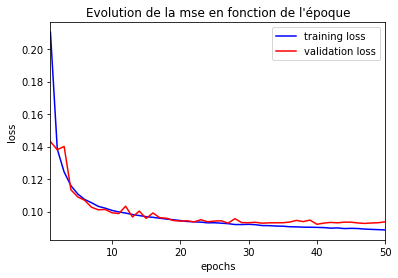

In [ ]:
label_e = 12 # identifiant unique de machine, entre 0 et 22

plt.figure()
n_epochs = len(histories[label_e]['loss'])
plt.plot(range(1, n_epochs+1), histories[label_e]['loss'], 
         'b', label='training loss')
plt.plot(range(1, n_epochs+1), histories[label_e]['val_loss'], 
         'r', label='validation loss')
plt.legend()
plt.xlim(1, n_epochs)
plt.title("Evolution de la mse en fonction de l'époque")
plt.xlabel('epochs')
plt.ylabel('loss');

## Evaluation du modèle

On peut maintenant comparer les scores obtenus à ceux donnés comme base au challenge original (on rappelle que la métrique utilisée est le ROC-AUC).

In [ ]:
baseline_scores = [81.36, 85.97, 63.30, 84.45, 78.07, 64.16, 75.35, 54.41, 
                   73.40, 61.61, 73.92, 67.15, 61.53, 88.33, 74.55, 96.19,
                   78.97, 94.30, 69.59, 68.76, 68.18, 74.30, 53.90]
result = df_test[['engine', 'ID']].groupby(['engine', 'ID']).count()
result['scores_AE'] = [round(100*s, 2) for s in scores]
result['baseline'] = baseline_scores
result

scores_AE  baseline
engine      ID                     
ToyCar      01      82.13     81.36
            02      85.76     85.97
            03      64.57     63.30
            04      86.33     84.45
ToyConveyor 01      77.34     78.07
            02      65.28     64.16
            03      77.31     75.35
fan         00      55.31     54.41
            02      81.49     73.40
            04      63.37     61.61
            06      91.80     73.92
pump        00      67.20     67.15
            02      58.21     61.53
            04      97.64     88.33
            06      77.39     74.55
slider      00      98.93     96.19
            02      82.64     78.97
            04      94.40     94.30
            06      75.22     69.59
valve       00      81.32     68.76
            02      76.13     68.18
            04      84.03     74.30
            06      69.58     53.90

On constate que nos résultats sont assez proches de la baseline, généralement un peu supérieurs. On peut faire une moyenne pour confirmer que l'on obtient un meilleur résultat global avec cette méthode.

In [ ]:
print("Moyenne obtenue :", round(result.scores_AE.mean(), 2))
print("Moyenne baseline :", round(result.baseline.mean(), 2))

Moyenne obtenue : 77.97
Moyenne baseline : 73.55


Il peut être intéressant de voir comment se répartit l'erreur suivant la machine, et quelle est la précision du modèle pour prédire la normalité d'un bruit en fonction du seuil choisi.

Le f1-score est de 85.39% pour ce seuil.


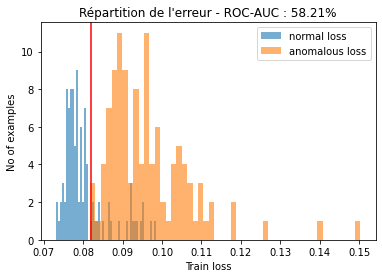

In [ ]:
label_e = 12 # identifiant unique de machine, entre 0 et 22
seuil = 0.082

# Récupération de l'erreur (mse) pour la machine identifiée
mse = df_test[df_test.label_e==label_e].mse
labels = df_test[df_test.label_e==label_e].label.astype(bool)

# Calcul du f1-score pour le seuil choisi
score_f1 = f1_score(labels, mse<seuil)
print("Le f1-score est de {:.2f}% pour ce seuil.".format(100*score_f1))

# Affichage de l'erreur (mse) pour la machine identifiée
plt.hist(mse[labels], bins=50, alpha=0.6, label='normal loss')
plt.hist(mse[~labels], bins=50, alpha=0.6, label='anomalous loss')
plt.axvline(seuil, c='r')
plt.xlabel("Train loss")
plt.ylabel("No of examples")
plt.title("Répartition de l'erreur - ROC-AUC : {:.2f}%".format(100*scores[label_e]))
plt.legend()
plt.show()

Il est intéressant d'écouter les données prédites comme normales alors qu'elles révèlent une anomalie. C'est ce qui peut être fait dans la cellule ci-après.

In [ ]:
label_e = 12 # identifiant unique de machine, entre 0 et 22

# Affichage d'un fichier Train
data = df_train[df_train.label_e==label_e].iloc[0]
file = data.audio_path
signal, fe = librosa.load(file, sr=None)

print(data.engine + ' - ID' + data.ID + ' - Normal')
print(file.split("/")[-1])
display(Audio(data=signal, rate=fe))

# Affichage d'un fichier Test mal classé
data = df_test[(df_test.label_e==label_e) & \
               (df_test.label==1) & (df_test.mse>seuil)].iloc[0]
file = data.audio_path
signal, fe = librosa.load(file, sr=None)

print(data.engine + ' - ID' + data.ID + ' - Prédit anormal')
print(file.split("/")[-1])
display(Audio(data=signal, rate=fe))

pump - ID02 - Normal
normal_id_02_00000000.wav


pump - ID02 - Prédit anormal
normal_id_02_00000001.wav


On constate que la différence n'est pas toujours notable pour justifier la prédiction...

# **Classification par CNN**

Le but ici est de classer nos données par machine, et de détecter les anomalies. 
La méthode va donc consister à construire un modèle de classification sur la base de cet ensemble dans un premier temps. Dans un second temps, nous tenterons de prédire à quelle machine correspond chaque bruit de l'ensemble test, et nous pourrons inférer la normalité de la machine sur la base de la probabilité d'appartenance à telle classe.

## Préparation des données

Nous pouvons utiliser ici les MFEC calculées dans la section précédente. Toutefois, nous ne fenêtrerons pas les signaux dans cette partie, et nous ferons donc travailler notre modèlle sur des données de 40064 (128x313) valeurs.

In [ ]:
Train.shape

(20119, 128, 313)

## Modèle

Séparons nos données rangées dans _train_ en 2 ensembles, train et test, pour entrainer notre modèle à reconnaître les différentes machines, et le valider sur l'ensemble test.

In [ ]:
label_train = df[df.dir=='train'].label_e

X_train, X_test, y_train, y_test = train_test_split(Train, label_train, 
                                                    test_size=0.2,
                                                    random_state=123)

num_classes = len(df.label_e.unique())

Pour la classification, nous utilisons le réseau de neurones à convolution défini ci-dessous.

In [ ]:
model = Sequential()
# Part 1
model.add(layers.Conv1D(64, kernel_size=5, input_shape=X_train.shape[1:]))
model.add(layers.Dropout(0.2))
model.add(layers.LeakyReLU())
model.add(layers.BatchNormalization())
model.add(layers.Conv1D(64, kernel_size=3))
model.add(layers.Dropout(0.2))
model.add(layers.LeakyReLU())
model.add(layers.BatchNormalization())
model.add(layers.Conv1D(64, kernel_size=1))
model.add(layers.LeakyReLU())
model.add(layers.BatchNormalization())
model.add(layers.MaxPooling1D(pool_size=2, strides=2))
model.add(layers.Dropout(0.2))
model.add(layers.Conv1D(64, kernel_size=3))
model.add(layers.Dropout(0.2))
model.add(layers.LeakyReLU())
model.add(layers.BatchNormalization())
model.add(layers.Conv1D(64, kernel_size=3))
model.add(layers.LeakyReLU())
model.add(layers.BatchNormalization())
model.add(layers.MaxPooling1D(pool_size=2, strides=2))
model.add(layers.Dropout(0.2))
model.add(layers.Conv1D(64, kernel_size=3))
model.add(layers.Dropout(0.2))
model.add(layers.LeakyReLU())
model.add(layers.BatchNormalization())
model.add(layers.Conv1D(64, kernel_size=3))
model.add(layers.Dropout(0.2))
model.add(layers.LeakyReLU())
model.add(layers.BatchNormalization())
model.add(layers.Conv1D(64, kernel_size=3))
model.add(layers.Dropout(0.2))
model.add(layers.LeakyReLU())
model.add(layers.BatchNormalization())
model.add(layers.Conv1D(64, kernel_size=3))
model.add(layers.LeakyReLU())
model.add(layers.BatchNormalization())
model.add(layers.MaxPooling1D(pool_size=2, strides=2))
model.add(layers.Dropout(0.2))
model.add(layers.Conv1D(128, kernel_size=1))
model.add(layers.Dropout(0.2))
model.add(layers.LeakyReLU())
model.add(layers.BatchNormalization())
model.add(layers.Conv1D(128, kernel_size=1))
model.add(layers.Dropout(0.2))
model.add(layers.LeakyReLU())
model.add(layers.BatchNormalization())
model.add(layers.Conv1D(256, kernel_size=1))
model.add(layers.Dropout(0.2))
model.add(layers.LeakyReLU())
model.add(layers.BatchNormalization())
model.add(layers.Conv1D(256, kernel_size=1))
model.add(layers.Dropout(0.2))
model.add(layers.LeakyReLU())
model.add(layers.BatchNormalization())
model.add(layers.Conv1D(256, kernel_size=1))
model.add(layers.Dropout(0.2))
model.add(layers.LeakyReLU())
model.add(layers.BatchNormalization())
model.add(layers.Conv1D(256, kernel_size=1))
model.add(layers.Dropout(0.2))
model.add(layers.LeakyReLU())
model.add(layers.BatchNormalization())
model.add(layers.Conv1D(64, kernel_size=1))
model.add(layers.Dropout(0.2))
model.add(layers.LeakyReLU())
model.add(layers.BatchNormalization())
model.add(layers.GlobalAveragePooling1D())
# Classification part
model.add(layers.Dense(64))
model.add(layers.Dropout(0.2))
model.add(layers.LeakyReLU())
model.add(layers.Dense(num_classes, activation='softmax'))

model.compile(loss='sparse_categorical_crossentropy',
              optimizer=optimizers.Adam(learning_rate=0.01),
              metrics=['accuracy'])
model.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv1d (Conv1D)              (None, 124, 64)           100224    
_________________________________________________________________
dropout_9 (Dropout)          (None, 124, 64)           0         
_________________________________________________________________
leaky_re_lu (LeakyReLU)      (None, 124, 64)           0         
_________________________________________________________________
batch_normalization_9 (Batch (None, 124, 64)           256       
_________________________________________________________________
conv1d_1 (Conv1D)            (None, 122, 64)           12352     
_________________________________________________________________
dropout_10 (Dropout)         (None, 122, 64)           0         
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 122, 64)          

In [ ]:
n_epochs = 500

def update_lr(epoch, lr):
    """
    Définition de l'évolution du learning rate lr en fonction de l'epoch.
    """
    if epoch <= 50:
        return 1e-3
    else:
        return 0.985*lr

lr_scheduler = callbacks.LearningRateScheduler(schedule=update_lr, verbose=0)

early_stopping = callbacks.EarlyStopping(monitor="val_loss", patience=10, mode='min',
                                         verbose=2, restore_best_weights=True)

history = model.fit(X_train, y_train,
                    validation_data=(X_test, y_test), 
                    verbose=1, batch_size=64, epochs=n_epochs,
                    callbacks=[lr_scheduler, early_stopping])

pred_train = model.predict(Train)
pred_test = model.predict(Test)
h = history.history

model.save('drive/My Drive/model_CNN')
with open('drive/My Drive/data_CNN', 'wb') as f:
    pickle.dump([h, pred_train, pred_test], f)

Epoch 1/500
252/252 [==============================] - 12s 28ms/step - loss: 2.6595 - accuracy: 0.1304 - val_loss: 2.2756 - val_accuracy: 0.2249
Epoch 2/500
252/252 [==============================] - 6s 24ms/step - loss: 2.1576 - accuracy: 0.2377 - val_loss: 1.7743 - val_accuracy: 0.3656
Epoch 3/500
252/252 [==============================] - 6s 24ms/step - loss: 1.8989 - accuracy: 0.3322 - val_loss: 1.8537 - val_accuracy: 0.3926
Epoch 4/500
252/252 [==============================] - 6s 24ms/step - loss: 1.7654 - accuracy: 0.3679 - val_loss: 1.5621 - val_accuracy: 0.4635
Epoch 5/500
252/252 [==============================] - 6s 23ms/step - loss: 1.6317 - accuracy: 0.4293 - val_loss: 1.4368 - val_accuracy: 0.4655
Epoch 6/500
252/252 [==============================] - 6s 23ms/step - loss: 1.5427 - accuracy: 0.4546 - val_loss: 1.4297 - val_accuracy: 0.4774
Epoch 7/500
252/252 [==============================] - 6s 24ms/step - loss: 1.4209 - accuracy: 0.5033 - val_loss: 1.1943 - val_accuracy

Il est toujours intéressant d'observer la manière dont le modèle a convergé au cours des époques.

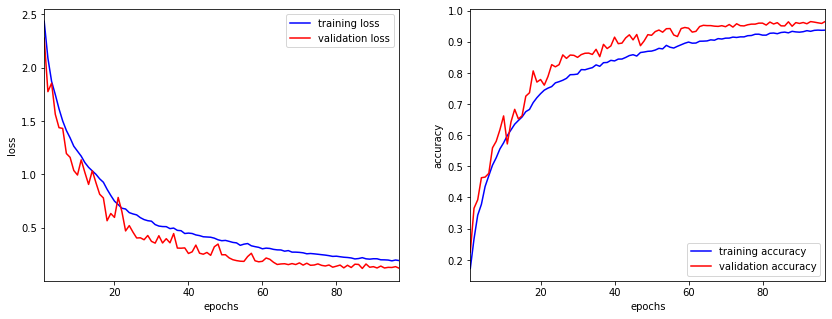

In [ ]:
plt.figure(figsize=(14, 5))
plt.subplot(121)
n_epochs = len(h['loss'])
plt.plot(range(1, n_epochs+1), h['loss'], 'b', label='training loss')
plt.plot(range(1, n_epochs+1), h['val_loss'], 'r', label='validation loss')
plt.legend()
plt.xlim(1, n_epochs)
plt.xlabel('epochs')
plt.ylabel('loss')
plt.subplot(122)
plt.plot(range(1, n_epochs+1), h['accuracy'], 'b', label='training accuracy')
plt.plot(range(1, n_epochs+1), h['val_accuracy'], 
         'r', label='validation accuracy')
plt.legend(loc=4)
plt.xlim(1, n_epochs)
plt.xlabel('epochs')
plt.ylabel('accuracy');

## Evaluation du modèle

Pour évaluer notre modèle, nous allons simplement visualiser la matrice de confusion entre les labels prédits et les labels réels. Nous ferons cette comparaison dans un premier temps sur l'ensemble train, puis sur l'ensemble test.

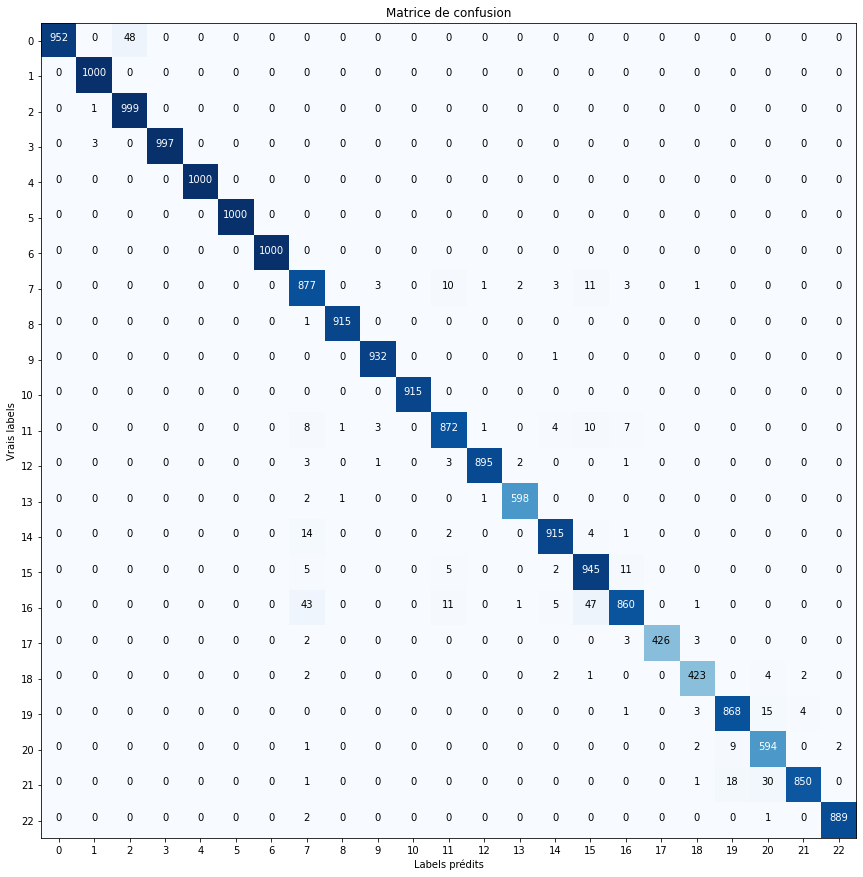

In [ ]:
label_train = df[df.dir=='train'].label_e
num_classes = len(df.label_e.unique())

cnf_matrix = confusion_matrix(label_train, pred_train.argmax(axis=1))
classes = df.label_e.unique()

plt.figure(figsize=(15,15))
plt.imshow(cnf_matrix, interpolation='nearest',cmap='Blues')
plt.title("Matrice de confusion")
tick_marks = np.arange(num_classes)
plt.xticks(tick_marks, classes)
plt.yticks(tick_marks, classes)

for i, j in itertools.product(range(cnf_matrix.shape[0]), 
                              range(cnf_matrix.shape[1])):
    plt.text(j, i, cnf_matrix[i, j],
            horizontalalignment="center",
            color="white" if cnf_matrix[i, j]>(cnf_matrix.max()/2) else "black")

plt.ylabel('Vrais labels')
plt.xlabel('Labels prédits')
plt.show()

In [ ]:
model.evaluate(Train, label_train)

629/629 [==============================] - 4s 6ms/step - loss: 0.0609 - accuracy: 0.9803


[0.06093079224228859, 0.9802674055099487]

On obtient une précision de 98% et une fonction de coût à 0.06 sur les données d'entrainement et de validation, ce qui signifie que notre modèle a bien convergé. Nous allons maintenant étudier sa performance sur les données test.

## Classification de l'ensemble test

Afin de classifier l'ensemble test par machine, nous allons utiliser les prédictions sur _test_ de notre modèle entrainé et validé sur les données des dossiers _train_.


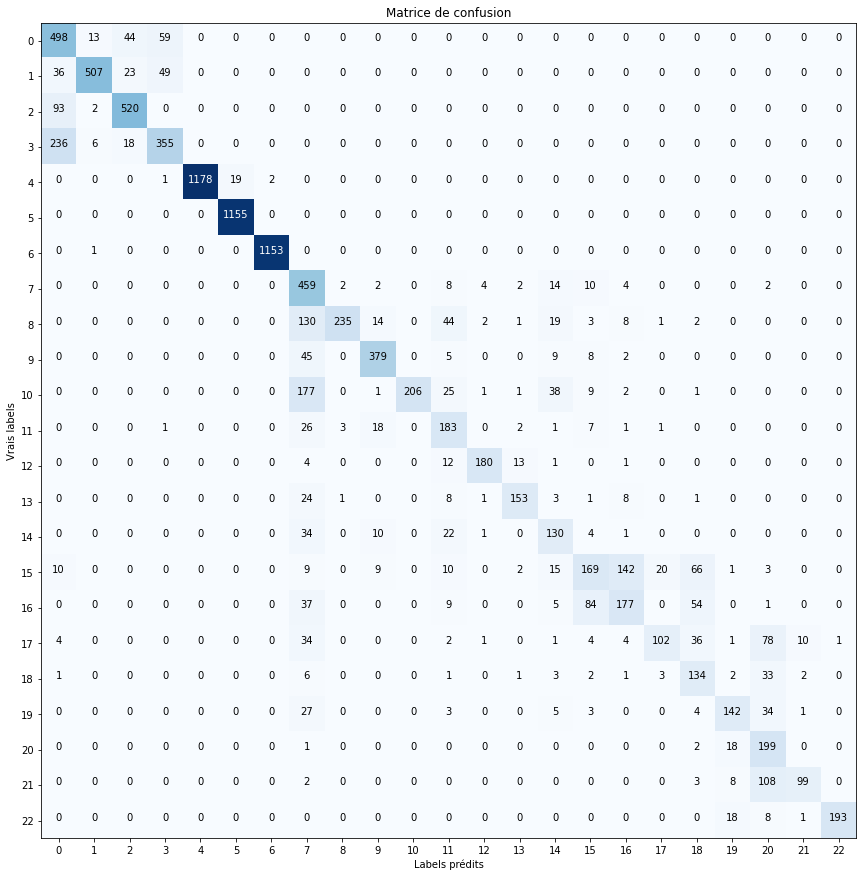

In [ ]:
label_test = df[df.dir=='test'].label_e

cnf_matrix = confusion_matrix(label_test, pred_test.argmax(axis=1))

plt.figure(figsize=(15,15))
plt.imshow(cnf_matrix, interpolation='nearest',cmap='Blues')
plt.title("Matrice de confusion")
tick_marks = np.arange(num_classes)
plt.xticks(tick_marks, classes)
plt.yticks(tick_marks, classes)

for i, j in itertools.product(range(cnf_matrix.shape[0]), range(cnf_matrix.shape[1])):
    plt.text(j, i, cnf_matrix[i, j],
            horizontalalignment="center",
            color="white" if cnf_matrix[i, j] > ( cnf_matrix.max()/2) else "black")

plt.ylabel('Vrais labels')
plt.xlabel('Labels prédits')
plt.show()

In [ ]:
model.evaluate(Test, label_test)

340/340 [==============================] - 2s 6ms/step - loss: 1.4329 - accuracy: 0.7827


[1.4328707456588745, 0.7826647162437439]

Sur les données de test, nous mesurons une précision de 78%, avec une fonction de coût qui atteint 1.4, valeur encore élevée que nous ne sommes pas parvenus à réduire.
Toutefois, on observe que les erreurs de prédiction se situent bien souvent à proximité de la machine cible, et nous pouvons vérifier qu'à défaut d'avoir prédit la machine, notre algorithme a au moins prédit le bon type de machine.

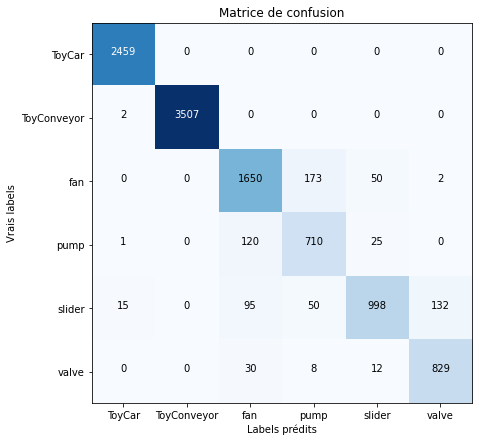

Accuracy: 93.42%


In [ ]:
engine_test = df_test.engine
engine_dic = {e[1]: e[0] for e in list(set(zip(df.engine, df.label_e)))}
engine_pred_test = [engine_dic[e] for e in pred_test.argmax(axis=1)]
df_test['class_pred'] = engine_pred_test

cnf_matrix = confusion_matrix(engine_test, engine_pred_test)
classes = df.engine.unique()

plt.figure(figsize=(7,7))
plt.imshow(cnf_matrix, interpolation='nearest',cmap='Blues')
plt.title("Matrice de confusion")
tick_marks = np.arange(len(classes))
plt.xticks(tick_marks, classes)
plt.yticks(tick_marks, classes)

for i, j in itertools.product(range(cnf_matrix.shape[0]), 
                              range(cnf_matrix.shape[1])):
    plt.text(j, i, cnf_matrix[i, j],
            horizontalalignment="center",
            color="white" if cnf_matrix[i, j]>(cnf_matrix.max()/2) else "black")

plt.ylabel('Vrais labels')
plt.xlabel('Labels prédits')
plt.show()
print('Accuracy: {:.2f}%'.format(100*cnf_matrix.trace()/cnf_matrix.sum()))

In [ ]:
print(classification_report(engine_test, engine_pred_test))

              precision    recall  f1-score   support

      ToyCar       0.99      1.00      1.00      2459
 ToyConveyor       1.00      1.00      1.00      3509
         fan       0.87      0.88      0.88      1875
        pump       0.75      0.83      0.79       856
      slider       0.92      0.77      0.84      1290
       valve       0.86      0.94      0.90       879

    accuracy                           0.93     10868
   macro avg       0.90      0.90      0.90     10868
weighted avg       0.94      0.93      0.93     10868



On mesure alors une précision de 93%, ce qui est bien mieux. On constate d'ailleurs que le ToyCar est parfaitement identifié comme tel, de même que le ToyConveyor, même si on a pu observer une confusion entre les différents ID.

Cette fois encore, on peut écouter les fichiers mal classés pour tenter de comprendre ce qui a pu causer la confusion. On ne considèrera que les erreurs de classification sur des types de machine, sous l'hypothèse que les machines du même type ont un bruit suffisamment proche pour considérer la confusion comme acceptable, d'autant que le but de notre projet n'est pas d'affiner cette distinction.

In [ ]:
label_e = 20 # identifiant unique de machine, entre 4 et 22

# Affichage d'un fichier Train
data = df_train[df_train.label_e==label_e].iloc[0]
file = data.audio_path
signal, fe = librosa.load(file, sr=None)

print(data.engine + ' - ID' + data.ID + ' - Normal')
print(file.split("/")[-1])
display(Audio(data=signal, rate=fe))

# Affichage d'un fichier Test mal classé
engine = df_test[df_test.label_e==label_e].engine.iloc[0]
data = df_test[(df_test.label_e==label_e) & (df_test.label==1) & \
               (df_test.class_pred!=df_test.engine)].iloc[0]
file = data.audio_path
signal, fe = librosa.load(file, sr=None)

print(data.engine + ' - ID' + data.ID + ' - Prédiction : ' + data.class_pred)
print(file.split("/")[-1])
display(Audio(data=signal, rate=fe))

valve - ID02 - Normal
normal_id_02_00000000.wav


valve - ID02 - Prédiction : slider
normal_id_02_00000027.wav


On constate que les erreurs de classification sont à la fois peu nombreuses pour les données normales,puisqu'on n'en trouve pas pour chaque label, et parfois inattendues dans la mesure où on ne perçoit pas ce qui a induit l'algorithme en erreur.

Dans tous les cas, rappelons que l'objectif principal de notre projet n'est pas de prédire la machine ou son type, mais si un bruit n'est pas normal. Pour ce faire, nous proposons dans un premier temps d'évaluer cela sur la base de la probabilité d'appartenance à une classe prédite par notre modèle.

## Diagnostic des données

Pour prédire si les bruits sont générés par une machine défaillante ou non, nous proposons d'utiliser la valeur de la probabilité ayant permis d'effectuer la classification précédente. Si cette probabilité est inférieure à un seuil à déterminer, nous en conclurons que le bruit est anormal.

Pour pouvoir comparer les résultats de cette partie à ceux obtenus dans la partie précédente, nous allons utiliser la même métrique, à savoir le ROC-AUC.

In [ ]:
scores = []
for l in df.label_e.unique(): # Boucle sur les identifiants uniques
    labels = df_test[df_test.label_e==l].label
    pred_e = pred_test[df_test.label_e==l]
    pred_proba = [p[p.argmax()] for p in pred_e]
    score = roc_auc_score(labels, pred_proba)
    scores.append(round(100*score, 2))

result.insert(1, "scores_CNN", scores) 
result

scores_AE  scores_CNN  baseline
engine      ID                                 
ToyCar      01      82.13       57.79     81.36
            02      85.76       81.85     85.97
            03      64.57       84.92     63.30
            04      86.33       67.72     84.45
ToyConveyor 01      77.34       77.82     78.07
            02      65.28       58.00     64.16
            03      77.31       61.17     75.35
fan         00      55.31       53.57     54.41
            02      81.49       99.44     73.40
            04      63.37       81.96     61.61
            06      91.80       91.64     73.92
pump        00      67.20       70.18     67.15
            02      58.21       78.40     61.53
            04      97.64       94.70     88.33
            06      77.39       72.17     74.55
slider      00      98.93       92.24     96.19
            02      82.64       79.83     78.97
            04      94.40       98.83     94.30
            06      75.22       95.25     69.59
valve       00      81.32       90.42     68.76
            02      76.13       75.68     68.18
            04      84.03       74.01     74.30
            06      69.58       84.80     53.90

In [ ]:
print("Moyenne CNN :", round(result.scores_CNN.mean(), 2))
print("Moyenne AE :", round(result.scores_AE.mean(), 2))
print("Moyenne baseline :", round(result.baseline.mean(), 2))

Moyenne CNN : 79.23
Moyenne AE : 77.97
Moyenne baseline : 73.55


On constate que les résultats obtenus ici sont plus éloignés de la baseline que les précédents : parfois bien en-dessous, d'autres fois bien supérieurs. Il en résulte néanmmoins une moyenne plus élevée pour le ROC-AUC.

Nous pourrions maintenant, comme précédemment, afficher la répartition des prédictions pour tenter de placer un seuil de décision.

Le f1-score est de 70.77% pour ce seuil.


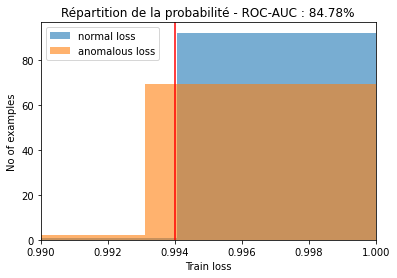

In [ ]:
label_e = 12 # identifiant unique de machine, entre 0 et 22
seuil = 0.994

# Récupération de la probabilité pour la machine identifiée
labels = df_test[df_test.label_e==l].label.astype(bool)
pred_e = pred_test[df_test.label_e==l]
pred_proba = np.asarray([p[p.argmax()] for p in pred_e])

# Calcul du f1-score pour le seuil choisi
score_f1 = f1_score(labels, pred_proba>seuil)
print("Le f1-score est de {:.2f}% pour ce seuil.".format(100*score_f1))

# Affichage de l'erreur (mse) pour la machine identifiée
plt.hist(pred_proba[labels], bins=100, alpha=0.6, label='normal loss')
plt.hist(pred_proba[~labels], bins=100, alpha=0.6, label='anomalous loss')
plt.axvline(seuil, c='r')
plt.xlabel("Train loss")
plt.ylabel("No of examples")
plt.title("Répartition de la probabilité - ROC-AUC : {:.2f}%".format(scores[label_e]))
plt.legend()
plt.xlim(0.99, 1)
plt.show()

On constate que les prédictions sont majoritairement très hautes, à plus de 99,9%, rendant ardu le placement d'un seuil visuellement.

Nous avons alors envisagé cette question comme une problématique d'optimisation, en cherchant le seuil permettant de maximiser le f1-score.

In [ ]:
# Optimisation de la valeur du seuil pour maximiser la précision
def error(seuil):
    """
    Renvoie l'erreur de prédiction en fonction du seuil donné.
    """
    normality = []
    for idx, i in enumerate(pred_test.argmax(axis=1)):
        normality.append(int(pred_test[idx,i]>=seuil))
    cnf_matrix = confusion_matrix(df_test.label, normality)
    return 1-cnf_matrix.trace()/cnf_matrix.sum() 

res = minimize(error, 1)

seuil = res.x
normality = []
for idx, i in enumerate(pred_test.argmax(axis=1)):
    normality.append(int(pred_test[idx,i]>=seuil))
print('Pour un seuil à {}, le f1-score est de {:.2f}%.' \
      .format(seuil[0], 100*cnf_matrix.trace()/cnf_matrix.sum()))

Pour un seuil à 0.9998461877066622, le f1-score est de 93.44%.


Ce résultat est très bon, et pourrait encore être amélioré en faisant ce travail d'optimisation pour chaque machine.
Toutefois, il nous semble que cette méthode n'est pas vraiment fiable, dans la mesure où une très faible variation sur ce seuil peut avoir une grande incidence sur les décisions puisque la grande majorité des probabilités est très proche de 1. Nous avons donc exploré d'autres possibilités, à partir de l'embedding, ce vecteur de dimension réduite qui se trouve dans notre modèle, juste avant la partie classification.

## Tentative de diagnostic à partir de l'embedding

Partant de cet embedding de dimension 64, nous avons des données de taille bien plus aisée à traiter. Nous proposons donc d'effectuer, pour chaque machine, un diagnostic de normalité par la méthode des k-Means.

In [ ]:
# Extraction de l'embedding de notre modèle
embedding = Model(inputs=model.input,
                  outputs=model.layers[-5].output)

In [ ]:
# Définition des fonctions pour la mise en oeuvre du modèle k-Means
def initilizeCentroids(data, k):
    """
    Initialisation des centroïdes de data à partir des k premières observations.
    """
    centroids = data[0:k]
    return centroids

def assignCentroids(X, C):
    """
    Assigne les centroïdes C les plus proches aux données X.
    """ 
    expanded_vectors = tf.expand_dims(X, 0)
    expanded_centroids = tf.expand_dims(C, 1)
    distance = tf.math.reduce_sum(tf.math.square(tf.math.subtract(expanded_vectors, 
                                                                  expanded_centroids)),
                                   axis=2)
    id_dist_min = tf.math.argmin(distance, 0)
    dist_max = tf.math.reduce_max(distance, axis=1)
    return id_dist_min
                                              
def reCalculateCentroids(X, X_labels):
    """
    Recalcule les centroïdes des données X.
    """
    sums = tf.math.unsorted_segment_sum(X, X_labels, k)
    counts = tf.math.unsorted_segment_sum(tf.ones_like(X ), X_labels, k)
    return tf.math.divide(sums, counts)   

In [ ]:
# Nombre de clusters 
k = 2

# Nombre d'itérations pour l'algorithme
epochs = 2000

a = []
df_test = df[df.dir=='test']
for l in df_test.label_e.unique(): # boucle sur chaque identifiant unique 
    data = embedding.predict(Test[df_test.label_e==l])

    X = tf.Variable(data, name="X")
    X_labels = tf.Variable(tf.zeros(shape=(X.shape[0], 1)), name="X_labels")
    C = tf.Variable(initilizeCentroids(data, k), name="C")

    for epoch in range(epochs):
        X_labels = assignCentroids(X, C)
        C = reCalculateCentroids(X, X_labels)

    test_pred = X_labels
    test_label = df_test[df_test.label_e==l].label

    cnf_matrix = confusion_matrix(test_label, test_pred)
    ri, ci = linear_sum_assignment(cnf_matrix, maximize=True)
    cnf_matrix = cnf_matrix[:,ci]
    a_l = cnf_matrix.trace()/cnf_matrix.sum()
    a.append(a_l)

In [ ]:
# Affichage des f1-scores obtenus par cette méthode
accuracy = df_test[['engine', 'ID']].groupby(['engine', 'ID']).count()
accuracy['scores_clustering'] = [round(100*x, 2) for x in a]
print('La précision moyenne est de {:.2f}%.' \
      .format(accuracy.scores_clustering.mean()))
accuracy

La précision moyenne est de 74.94%.


scores_clustering
engine      ID                   
ToyCar      01              73.62
            02              80.65
            03              78.86
            04              95.77
ToyConveyor 01              78.67
            02              51.43
            03              57.80
fan         00              53.65
            02              97.82
            04              66.74
            06              77.22
pump        00              50.62
            02              73.93
            04              92.50
            06              69.31
slider      00              94.52
            02              56.68
            04              97.84
            06              88.36
valve       00              83.11
            02              50.45
            04              83.64
            06              70.45

Nous obtenons par cette méthode un f1-score moyen de 75%, ce qui n'est pas mauvais mais doit pouvoir être amélioré.
Dans cet objectif, nous explorons la possibilité de distinguer les anomalies par PCA.

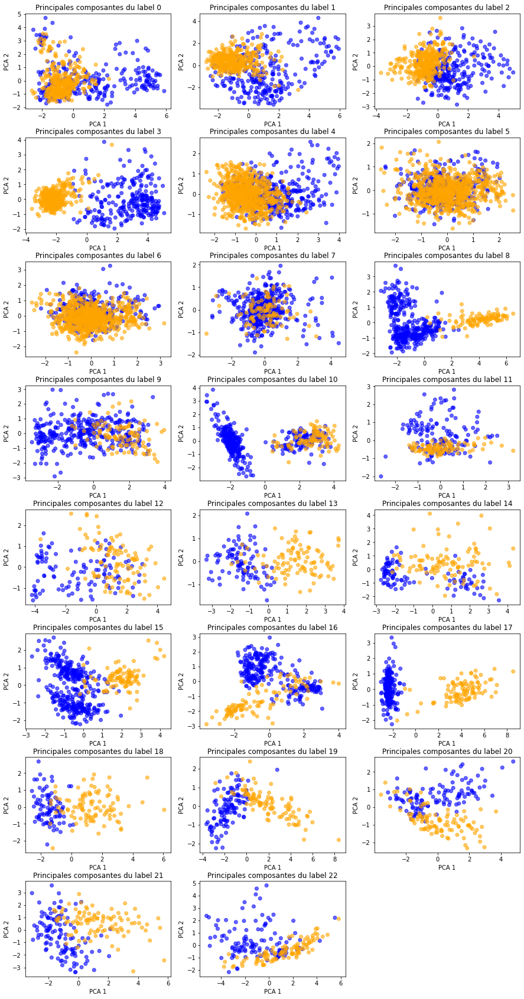

In [ ]:
# Affichage des résultats d'une PCA à 2 dimensions pour chaque machine
plt.figure(figsize=(15, 30))
for l in df_test.label_e.unique():
    embedded = embedding.predict(Test[df_test.label_e==l])
    pca = PCA(n_components=2, svd_solver='randomized')
    pred = pca.fit_transform(embedded)

    colors = [list(zip([0, 1],
                     ['blue', 'orange']))[i][1] for i in df_test[df_test.label_e==l].label]
    plt.subplot(8, 3, l+1)
    plt.scatter(pred[:,0], pred[:,1], c=colors, alpha=0.6)
    plt.xlabel('PCA 1')
    plt.ylabel('PCA 2')
    plt.title('Principales composantes du label {}'.format(l))
plt.subplots_adjust(hspace=0.3);

On observe que les labels pour lesquels la distinction est nette (3-ToyCar 04, 8-fan 02, 13-pump 04, 15-slider 00, 17-slider 02, 18-slider 03, 19-valve 00, 21-valve 04) correspondent à ceux pour lesquels le score obtenu par la méthode des k-means est très bon. Cette méthode ne semble donc rien apporter.

# **Conclusion**

Pour conclure, ce projet s'est montré instructif à bien des égards.

D'une part, nos données, de par leur format et ce qu'elles représentent, ne nous ont pas permis d'effectuer une fine analyse statistique, mais leur mise en forme pour exploitation a constitué un premier défi pour nous.

Par ailleurs, la problématique de détection d'anomalie nous a permis de mettre en oeuvre plusieurs types de modèles de deep learning : classification, clustering, auto-encodeurs. Pour les modèles enseignés au cours de la formation, c'était une bonne occasion de les mettre en application et de jouer avec les paramètres pour étudier leur incidence. Concernant les auto-encodeurs, nous avons été amenés à les découvrir par nous-mêmes, et la mise en application directe a été formatrice.
Ainsi, nous avons pu développer une meilleure compréhensions de différents paramètres des couches (strides sur les couches convolutives par exemple), de l'impact du choix de l'activation, de l'optimiseur, de la fonction de coût, ..., en évaluant leur impact direct sur la convergence ou les résultats du modèle. Ces éléments constituent un début d'expérience qui pourra nous aider à nous orienter dans le métier.

D'autre part, les résultats que nous obtenons avec nos deux modèles sont corrects, globalement meilleurs que ceux affichés par la baseline du challenge initial. Bien que l'on puisse considérer le classifieur CNN comme globalement plus performant que l'auto-encodeur convolutif, l'étude des résultats montre que suivant le type de machine, c'est l'auto-encodeur qui est plus pertinent. En tous cas, nous avons une solution qui permet de déterminer si une machine est anormale avec une précision moyenne de 75% (l'étendue des précisions allant de 50% (notre modèle est alors inutile), à 98%).

Pour finir, rappelons qu'alors que nos résultats en termes de score ROC-AUC moyen se situent entre 78 et 79% pour nos deux modèles, les meilleurs résultats au challenge dépassent les 90%. Nous avons donc encore du chemin à parcourir !

# **Chargement des données**

In [ ]:
# Chargement du df
df = pd.read_feather('drive/My Drive/df.feather')
engines = df.engine.unique()

In [ ]:
# Chargement des sorties des modèles
with open('drive/My Drive/data_AE', 'rb') as f:
    data = pickle.load(f)
histories = data[0]
scores = data[1]

with open('drive/My Drive/data_CNN', 'rb') as f:
    data = pickle.load(f)
h = data[0]
pred_train = data[1]
pred_test = data[2]

df = pd.read_feather('drive/My Drive/df.feather')
df_test = pd.read_feather('drive/My Drive/df_test.feather')
df_train = df[df.dir=='train']
engines = df.engine.unique()

In [ ]:
# Chargement des entrées du classifieur conv
Train = np.load('drive/My Drive/Train_MFEC.npy')
Test = np.load('drive/My Drive/Test_MFEC.npy')

df = pd.read_feather('drive/My Drive/df.feather')
engines = df.engine.unique()

In [ ]:
# Chargement du classifieur conv
model = load_model("drive/My Drive/model_CNN")